### Testing already trained models

In [1]:
import os
from os.path import join
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.multiprocessing as mp
from torch.distributed import init_process_group, destroy_process_group
from torch.utils.data.distributed import DistributedSampler
from torch.utils.data import DataLoader
from astropy.io import fits
import pyxis.torch as pxt
import pyxis as px
import scipy.optimize as so

from networks import *
from train import *
import config

stem = 'CNN-CNN-flow_1m_LN'
data_dir = '/ocean/projects/phy250048p/shared/datasets/test_1m'
samp_dir = '/ocean/projects/phy250048p/shared/samples/samples_test_1m.csv'
fig_dir = '/ocean/projects/phy250048p/shared/figures/'
model_dir = f'/ocean/projects/phy250048p/shared/models/{stem}/'
loss_dir = '/ocean/projects/phy250048p/shared/models/losses/'
results_dir = '/ocean/projects/phy250048p/shared/results/'

In [2]:
def denormalize(samples):
    denorm = np.empty_like(samples)
    denorm[:, 0] = samples[:, 0]
    for i, par in enumerate(par_ranges.values()):
        low, high = par
        values = samples[:, i+1]
        values += 1
        values *= (high-low)/2
        values += low
        denorm[:, i+1] = values
    return denorm

In [3]:
def find_confidence_interval(x, pdf, confidence_level):
    return pdf[pdf > x].sum() - confidence_level

def density_contour(xdata, ydata, nbins_x, nbins_y, ax=None, **contour_kwargs):
    """ Create a density contour plot.
    Parameters
    ----------
    xdata : numpy.ndarray
    ydata : numpy.ndarray
    nbins_x : int
        Number of bins along x dimension
    nbins_y : int
        Number of bins along y dimension
    ax : matplotlib.Axes (optional)
        If supplied, plot the contour to this axis. Otherwise, open a new figure
    contour_kwargs : dict
        kwargs to be passed to pyplot.contour()
        
    Example Usage
    -------------
     density_contour(x pos, y pos, contour res, contour res, axis, colors for contours)
     e.g.:
     density_contour(xD, yD, 80, 80, ax=ax, 
         colors=['red','orange', 'yellow', 'orange', 'yellow'])

    """

    H, xedges, yedges = np.histogram2d(xdata, ydata, bins=(nbins_x,nbins_y), density=True)
    # NOTE : if you are using the latest version of python, in the above: 
    # instead of normed=True, use density=True
    
    x_bin_sizes = (xedges[1:] - xedges[:-1]).reshape((1,nbins_x))
    y_bin_sizes = (yedges[1:] - yedges[:-1]).reshape((nbins_y,1))

    pdf = (H*(x_bin_sizes*y_bin_sizes))
    
    X, Y = 0.5*(xedges[1:]+xedges[:-1]), 0.5*(yedges[1:]+yedges[:-1])
    Z = pdf.T
    
    ### Adjust Here #### 
    
    # Contour Levels Definitions
    zero = so.brentq(find_confidence_interval, 0., 1., args=(pdf, 0.))
    one_sigma = so.brentq(find_confidence_interval, 0., 1., args=(pdf, 0.68))
    two_sigma = so.brentq(find_confidence_interval, 0., 1., args=(pdf, 0.95))


    # Array of Contour levels. Adjust according to the above
    levels = [zero, one_sigma, two_sigma][::-1]

    ###### 
    
    if ax == None:
        contour = plt.contourf(X, Y, Z, levels=levels, origin="lower", alpha=0.5, **contour_kwargs)

    else:
        contour = ax.contourf(X, Y, Z, levels=levels, origin="lower", alpha=0.5, **contour_kwargs)
    
    return contour

In [4]:
def make_g_scatter(g1, g2, g1_diff, g2_diff, c=None, cmap='viridis', s=1, cbar_name='SNR', save=True, filename=f'g_{stem}_scatter.jpg'):
    plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
    fig,axes = plt.subplots(1,2,sharey=True,figsize=(18,6))
    
    axes[0].scatter(g1, g1_diff, c=c, cmap=cmap, s=s)
    scat = axes[1].scatter(g2, g2_diff, c=c, cmap=cmap, s=s)
    axes[0].set_ylim(-0.1,0.1)
    
    for i in range(2):
        axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
        
    axes[0].set_xlabel(r'$g_+^{true}$',fontsize=20)
    axes[1].set_xlabel(r'$g_x^{true}$',fontsize=20)
    axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)
    
    axes[0].tick_params(axis='both',which='major',labelsize=15)
    axes[1].tick_params(axis='x',which='major',labelsize=15)
    
    fig.subplots_adjust(wspace=0.08,hspace=0.06)
    
    fig.subplots_adjust(right=0.8)
    
    cbar = plt.colorbar(scat, ax=axes)
    cbar.set_label(cbar_name)
    
    # plt.tight_layout()
    if save:
        plt.savefig(join(fig_dir, f'{stem}/{filename}'))

In [5]:
def make_g_contour(g1, g2, g1_diff, g2_diff, axis='12', nbins=25, mask=None, anti_mask=False, legend_str_list=[], save=True, filename=f'g_{stem}_contour.jpg'):
    plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
    fig = plt.figure(figsize=(8,6))
    fig1,axes = plt.subplots(1,2,sharey=True,figsize=(13,6))

    if anti_mask:
        density_contour(g1[~mask], g1_diff[~mask], nbins, nbins, ax=axes[0], colors=['salmon', 'red'])
        contour = density_contour(g2[~mask], g2_diff[~mask], nbins, nbins, ax=axes[1], colors=['salmon', 'red'])
        handles, _ = contour.legend_elements()
    else:
        density_contour(g1, g1_diff, nbins, nbins, ax=axes[0], colors=['salmon', 'red'])
        contour = density_contour(g2, g2_diff, nbins, nbins, ax=axes[1], colors=['salmon', 'red'])
        handles, _ = contour.legend_elements()
    if mask is not None:
        density_contour(g1[mask], g1_diff[mask], nbins, nbins, ax=axes[0], colors=['lightsteelblue', 'cornflowerblue'])
        contour1 = density_contour(g2[mask], g2_diff[mask], nbins, nbins, ax=axes[1], colors=['lightsteelblue', 'cornflowerblue'])
        handles1, _ = contour1.legend_elements()
        handles += handles1
    axes[0].set_ylim(-0.1,0.1)
    
    for i in range(2):
        axes[i].axhline(0,color='k',linestyle='--',linewidth=3)

    if axis == '12':
        axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
        axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
    elif axis == 'pc':
        axes[0].set_xlabel(r'$g_+^{true}$',fontsize=20)
        axes[1].set_xlabel(r'$g_x^{true}$',fontsize=20)
    axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)
    
    axes[0].tick_params(axis='both',which='major',labelsize=15)
    axes[1].tick_params(axis='x',which='major',labelsize=15)
    
    plt.legend(handles, legend_str_list, fontsize=16)
    
    fig1.subplots_adjust(wspace=0.08,hspace=0.06)
    
    fig1.subplots_adjust(right=0.8)
    
    plt.tight_layout()
    if save:
        plt.savefig(join(fig_dir, f'{stem}/{filename}'))

In [6]:
def gaussian_2d(x, y, xx, yy, A, sigma):
    coeff = A/(2*np.pi*sigma**2)
    exp = -((xx-x)**2 + (yy-y)**2)/(2*np.pi*sigma**2)
    return coeff * torch.exp(exp)

def add_blobs(img, nblobs, avg_amp, avg_size):
    blob_img = torch.zeros_like(img, dtype=torch.float32)
    grid_size = 48
    xx, yy = torch.meshgrid(torch.linspace(0, grid_size, grid_size), torch.linspace(0, grid_size, grid_size), indexing='ij')
    for i in range(nblobs):
        x, y = torch.rand(2) * grid_size
        A = np.random.normal(avg_amp, 0.3*avg_amp) * (-1)**i
        sigma = np.random.normal(avg_size, 0.3*avg_size)
        blob_img[0] += gaussian_2d(x, y, xx, yy, A, sigma)
    new_img = img + blob_img
    return new_img, blob_img

In [3]:
os.makedirs(join(fig_dir, stem), exist_ok=True)

#### Generate loss plot

In [2]:
losses = pd.read_csv(join(loss_dir, f'losses_{stem}.csv'))
# nans_infs = pd.read_csv(join(loss_dir, f'nans_infs_{stem}.csv'))

In [3]:
train_losses = losses.iloc[0, :]
valid_losses = losses.iloc[1, :]
epoch = np.arange(1, losses.shape[1]+1)

In [4]:
valid_losses[-2]

/var/tmp/ipykernel_54167/237616781.py:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valid_losses[-2]


0.021853602564428

In [5]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})

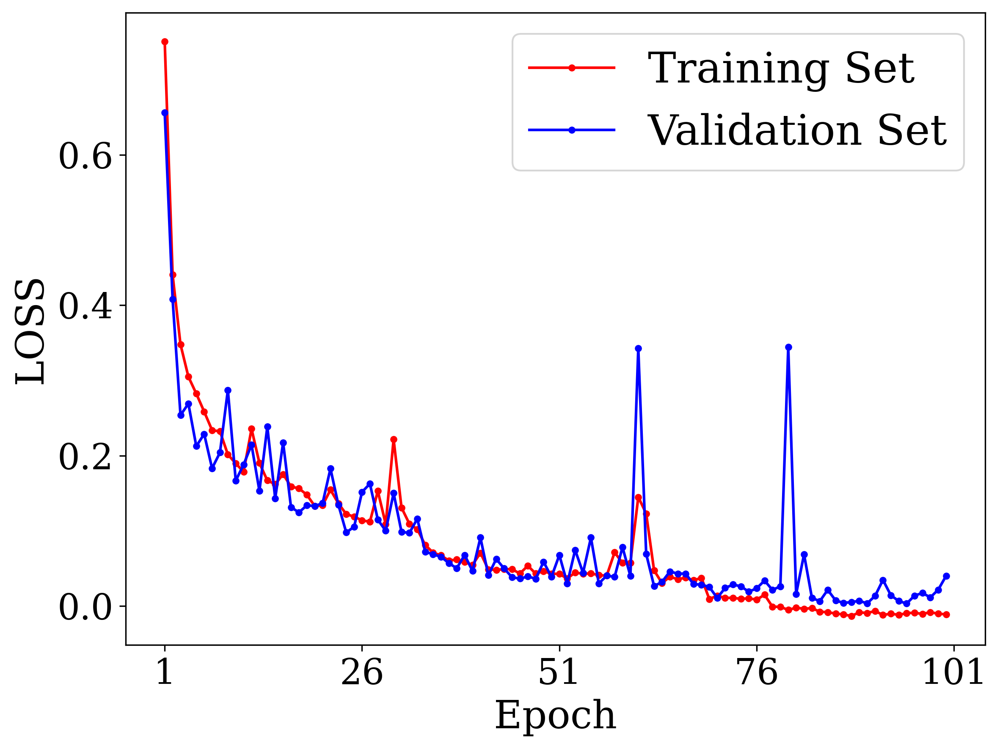

In [6]:
plt.figure(figsize=(8, 6))

plt.plot(epoch[0:], train_losses[0:], 'r.-', label="Training Set")
plt.plot(epoch[0:], valid_losses[0:], 'b.-', label='Validation Set')

plt.xlabel("Epoch", fontsize=22)
plt.ylabel("LOSS", fontsize=22)
plt.tick_params(axis='both',which='major',labelsize=20)
plt.xticks(np.linspace(1, losses.shape[1]+1, 5))
# plt.yscale('log')
plt.legend(fontsize=24)
plt.tight_layout()
plt.savefig(join(fig_dir, f'losses/{stem}_loss.jpg'))
plt.show()

### Start here to test model

In [7]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [8]:
model_file = join(model_dir, f'{stem}97')
model = load_model(mode=1, path=model_file,strict=True, assign=True, device=device)

In [9]:
print(model)

ForkCNN(
  (img_net): ImgCNN(
    (cnn_img): Sequential(
      (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (7): ResidualBlock(
        (cnn1): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (cnn2): Sequential(
          (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (1): BatchNorm2d(

In [10]:
# Get data loader
test_args = list(config.test.values())
test_ds = pxt.TorchDataset(data_dir)
test_dl = DataLoader(test_ds,
                     batch_size=100,
                     pin_memory=True,
                     shuffle=False,)

In [11]:
len(test_ds)

100000

In [63]:
def apply_noise(data, snr, device='cpu'):
    noise = torch.randn_like(data, device=device)
    maxs = torch.amax(data, dim=(-1, -2, -3))
    seg = data > 0.1*maxs.view(-1, 1, 1, 1)
    npix = torch.sum(seg, dim=(-1, -2, -3))
    total = torch.sum(data, dim=(-1, -2, -3))
    factor = total/(npix**0.5*snr)
    print(noise.shape, maxs.shape, seg.shape, npix.shape, total.shape, factor.shape)
    print(maxs, npix, total, factor)
    data = data + noise*factor.view(-1, 1, 1, 1)
    #mean = data.mean()
    #std = data.std()
    #return (data-mean)/std
    return data

In [70]:
img = test_ds[0]['img'].float().to(device).repeat(5, 1, 1, 1)
spec = test_ds[0]['spec'].float().to(device).repeat(5, 1, 1, 1)
snr = torch.tensor([25, 100, 250, 500, 1000]).to(device)

In [71]:
model.eval()
img_wnoise = apply_noise(img, snr, device=device).cpu().numpy()
spec_wnoise = apply_noise(spec, snr, device=device).cpu().numpy()

torch.Size([5, 1, 48, 48]) torch.Size([5]) torch.Size([5, 1, 48, 48]) torch.Size([5]) torch.Size([5]) torch.Size([5])
tensor([9.3939, 9.3939, 9.3939, 9.3939, 9.3939], device='cuda:0') tensor([662, 662, 662, 662, 662], device='cuda:0') tensor([2326.0679, 2326.0679, 2326.0679, 2326.0679, 2326.0679],
       device='cuda:0') tensor([3.6162, 0.9041, 0.3616, 0.1808, 0.0904], device='cuda:0')
torch.Size([5, 1, 3, 64]) torch.Size([5]) torch.Size([5, 1, 3, 64]) torch.Size([5]) torch.Size([5]) torch.Size([5])
tensor([23.6510, 23.6510, 23.6510, 23.6510, 23.6510], device='cuda:0') tensor([19, 19, 19, 19, 19], device='cuda:0') tensor([400.2362, 400.2362, 400.2362, 400.2362, 400.2362], device='cuda:0') tensor([3.6728, 0.9182, 0.3673, 0.1836, 0.0918], device='cuda:0')


In [54]:
img_wnoise.shape

(5, 1, 48, 48)

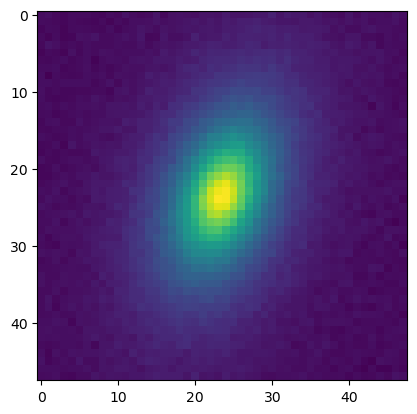

In [72]:
plt.imshow(img_wnoise[4,0])

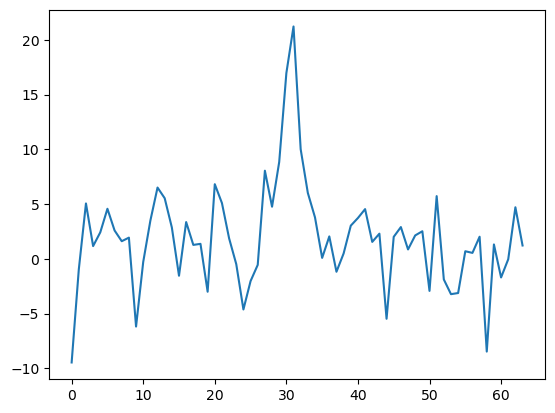

In [69]:
plt.plot(spec_wnoise[0,0,0])

### Code to test flow models

In [17]:
grid_size = 100
xx, yy = torch.meshgrid(torch.linspace(-1, 1, grid_size), torch.linspace(-1, 1, grid_size), indexing='ij')
zz = torch.cat([xx.unsqueeze(2), yy.unsqueeze(2)], 2).view(-1, 2)
zz = zz.to(device)

In [18]:
print(zz.shape)

torch.Size([10000, 2])


In [19]:
ngals = 100

In [20]:
g_true = torch.zeros((ngals,2), dtype=torch.float32).to(device)
for i in range(g_true.shape[0]):
    g_true[i] = test_ds[i]['fid_pars'][:2]

In [21]:
log_probs, true, SNR, img, spec = estimate_density(zz, test_ds, model, ngals, device)

In [14]:
ID = 1

In [15]:
prob = np.reshape(np.exp(log_probs[ID]), (100, 100))
point = true[ID]

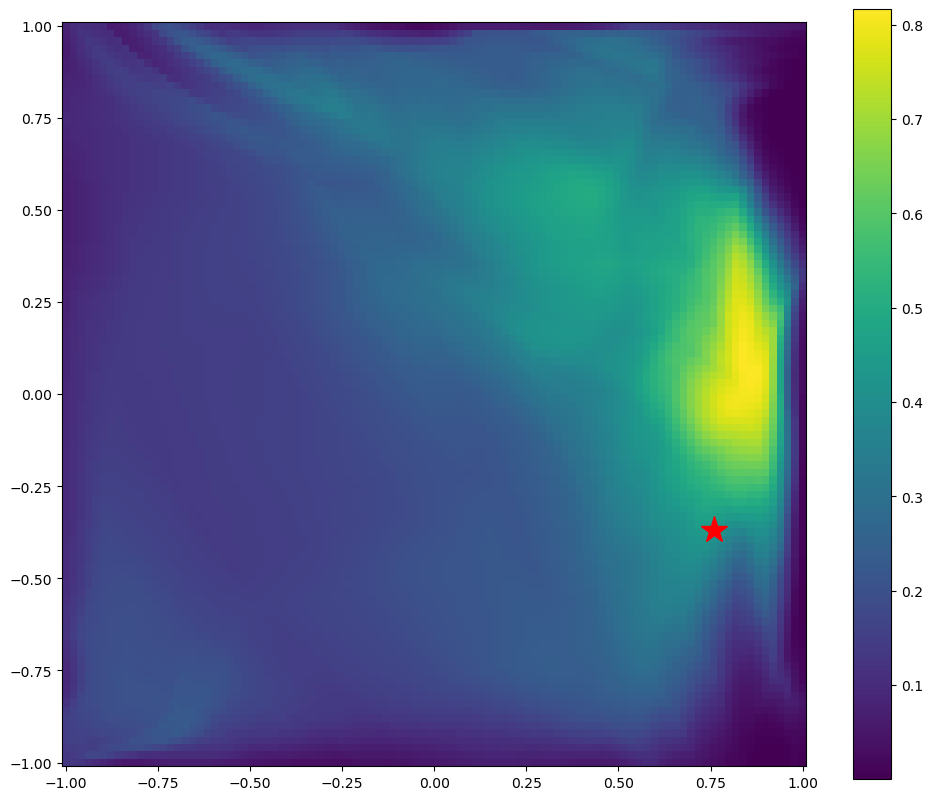

In [17]:
plt.figure(figsize=(12, 10))
plt.pcolormesh(xx, yy, prob, shading='auto')
plt.plot(point[0], point[1], '*', markersize=20, color='red')
plt.gca().set_aspect('equal', 'box')
plt.colorbar()
plt.savefig(join(fig_dir, f'{stem}/log_prob_{ID}.jpg'))
plt.show()

In [17]:
for i in range(100):
    prob = np.reshape(np.exp(log_probs[i]), (100, 100))
    point = true[i]
    plt.figure(figsize=(12, 10))
    plt.pcolormesh(xx, yy, prob, shading='auto')
    plt.plot(point[0], point[1], '*', markersize=20, color='red')
    plt.gca().set_aspect('equal', 'box')
    plt.colorbar()
    plt.savefig(join(fig_dir, f'{stem}/log_prob_{i}.jpg'))
    plt.close()

In [17]:
mles = np.zeros((ngals, 2), dtype=np.float32)
for i in range(ngals):
    index = np.argmax(log_probs[i])
    mles[i] = [xx.flatten()[index], yy.flatten()[index]]

In [18]:
g_scale = 0.1

In [19]:
g1_true = g_true[:, 0].cpu().numpy() * g_scale
g2_true = g_true[:, 1].cpu().numpy() * g_scale
# g1_diff = expectations[:, 0] - g1_true
# g2_diff = expectations[:, 1] - g2_true
g1_pred = mles[:, 0] * g_scale
g2_pred = mles[:, 1] * g_scale
g1_diff = g1_pred - g1_true
g2_diff = g2_pred - g2_true

In [20]:
samples = pd.read_csv(samp_dir)
theta = np.array(samples['theta_int'])[:ngals]

In [21]:
gp_true = g1_true*np.cos(2*theta) - g2_true*np.sin(2*theta)
gc_true = g1_true*np.sin(2*theta) + g2_true*np.cos(2*theta)
gp_pred = (mles[:, 0]*np.cos(2*theta) - mles[:, 1]*np.sin(2*theta)) * g_scale
gc_pred = (mles[:, 0]*np.sin(2*theta) + mles[:, 1]*np.cos(2*theta)) * g_scale
gp_diff = gp_pred - gp_true
gc_diff = gc_pred - gc_true

In [22]:
whr = np.where((gp_diff < 0.001) & (gc_diff < 0.001) & (g1_diff < 0.001) & (g2_diff < 0.001))

In [23]:
whr[0].shape

(422,)

In [24]:
whr[0][0]

22

In [83]:
case_img = test_ds[22]['img']
case_spec = test_ds[22]['spec']
case_fid = test_ds[22]['fid_pars'][:2]

In [102]:
model.eval()
case_true = []
case_log_probs = []
case_snrs = []
iters = 2000
with torch.no_grad():
    for i in range(iters):
        snr = torch.rand((),device=device)*190 + 10
        new_img, blob_img = add_blobs(case_img, 26, 2, 2)
        # new_img = case_img
        img = apply_noise(new_img.float().to(device), snr, device=device)
        spec = apply_noise(case_spec.float().to(device), snr, device=device)
        fid = case_fid.float().to(device)
        log_prob = model.estimate_log_prob(img, spec, zz)
        case_log_probs.append(log_prob.detach().cpu().numpy())
        case_true.append(fid.cpu().numpy())
        case_snrs.append(snr.cpu().numpy())
case_true = np.array(case_true)
case_snrs = np.array(case_snrs)

In [103]:
case_mles = np.zeros((iters, 2), dtype=np.float32)
for i in range(iters):
    index = np.argmax(case_log_probs[i])
    case_mles[i] = [xx.flatten()[index], yy.flatten()[index]]

In [104]:
case_true = case_true * g_scale

In [105]:
case_theta = theta[6]
gp_case_true = case_true[:, 0]*np.cos(2*case_theta) - case_true[:, 1]*np.sin(2*case_theta)
gc_case_true = case_true[:, 0]*np.sin(2*case_theta) + case_true[:, 1]*np.cos(2*case_theta)
gp_case_pred = (case_mles[:, 0]*np.cos(2*case_theta) - case_mles[:, 1]*np.sin(2*case_theta)) * g_scale
gc_case_pred = (case_mles[:, 0]*np.sin(2*case_theta) + case_mles[:, 1]*np.cos(2*case_theta)) * g_scale
gp_case_diff = gp_case_pred - gp_case_true
gc_case_diff = gc_case_pred - gc_case_true

In [106]:
print(gc_case_true[0])

0.08205761


In [107]:
gp_round = np.round(gp_case_true[0], 3)
gc_round = np.round(gc_case_true[0], 3)

In [108]:
print(gp_round, gc_round)

0.001 0.082


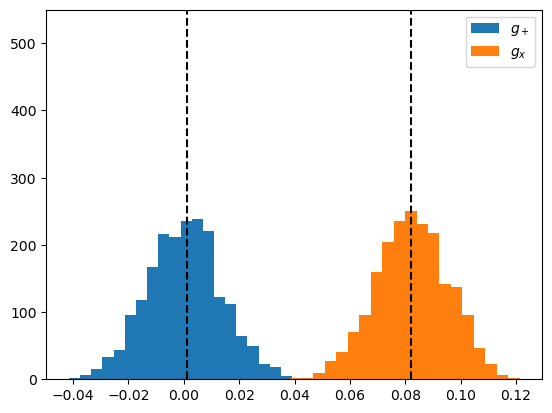

In [109]:
plt.hist(gp_case_pred, bins=20, label=r'$g_+$')
plt.hist(gc_case_pred, bins=20, label=r'$g_x$')
plt.vlines((gp_round, gc_round), 0, 550, linestyles='--', colors='black')
plt.ylim(0, 550)
plt.legend()
plt.savefig(join(fig_dir, f'{stem}/gx_{stem}_img_perturb_26_blobs_strong.jpg'))
plt.show()

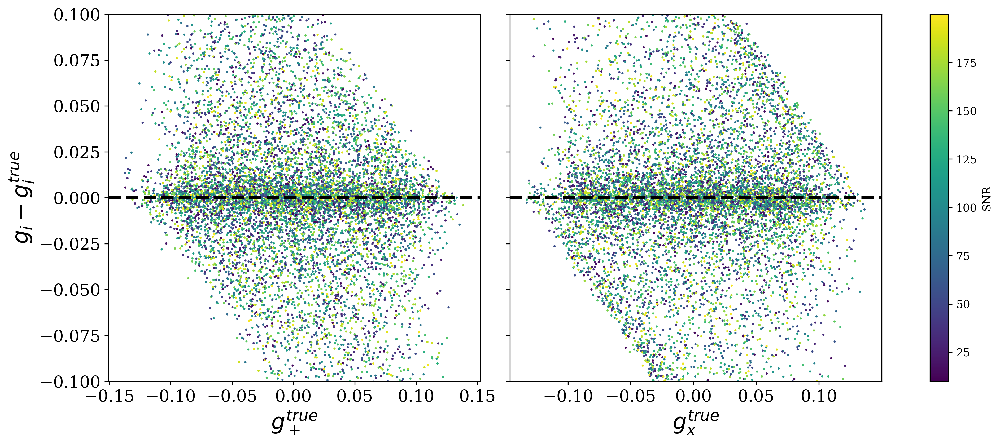

In [25]:
make_g_scatter(gp_true, gc_true, gp_diff, gc_diff, c=SNR, filename=f'gx_{stem}_scatter_mle_SNR.jpg')
plt.show()

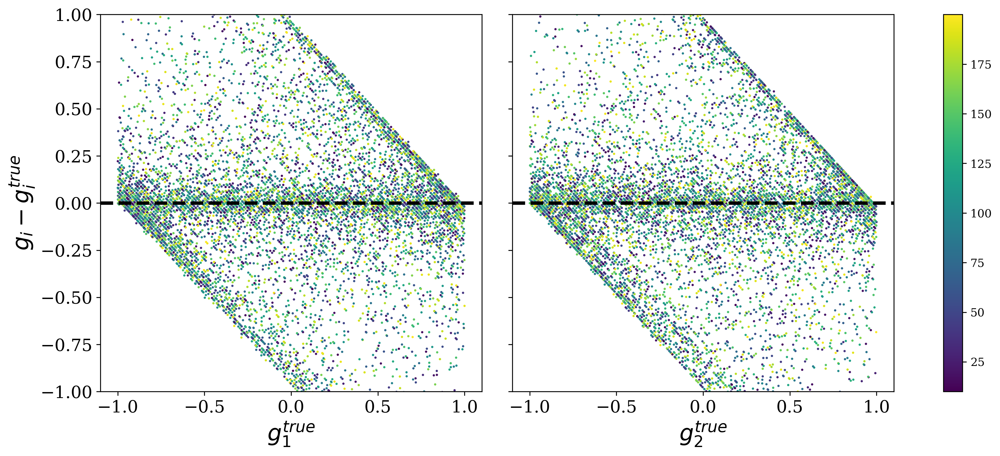

In [18]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig,axes = plt.subplots(1,2,sharey=True,figsize=(18,6))

# snr_mask = SNR > 100

# axes[0].scatter(g1_true, g1_diff, s=10)
# axes[1].scatter(g2_true, g2_diff, s=10)
axes[0].scatter(g1_true, g1_diff, c=SNR, cmap='viridis', s=1)
scat = axes[1].scatter(g2_true, g2_diff, c=SNR, cmap='viridis', s=1)
axes[0].set_ylim(-1,1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

fig.subplots_adjust(wspace=0.08,hspace=0.06)

fig.subplots_adjust(right=0.8)

plt.colorbar(scat, ax=axes)

# plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_scatter_mle.jpg'))
plt.show()

In [46]:
sini = np.array(samples['sini'])

<Figure size 2400x1800 with 0 Axes>

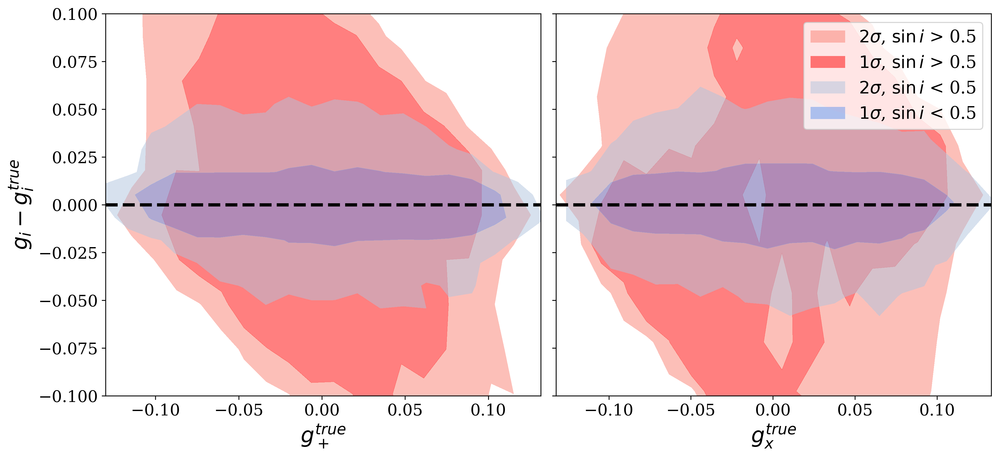

In [48]:
legend_str_list = [r'$2\sigma$, $\sin i$ > 0.5', r'$1\sigma$, $\sin i$ > 0.5', 
                   r'$2\sigma$, $\sin i$ < 0.5', r'$1\sigma$, $\sin i$ < 0.5']
sini_mask = sini[:ngals] < 0.5
make_g_contour(gp_true, gc_true, gp_diff, gc_diff, axis='pc', nbins=20, mask=sini_mask, anti_mask=True, legend_str_list=legend_str_list, save=True, filename=f'gx_{stem}_contour_sini_2.jpg')
plt.show()

<Figure size 2400x1800 with 0 Axes>

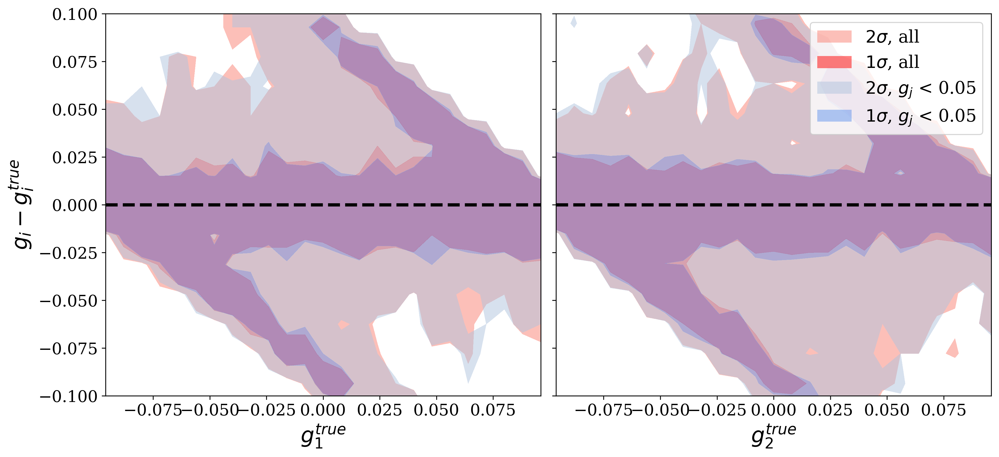

In [82]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig = plt.figure(figsize=(8,6))
fig1,axes = plt.subplots(1,2,sharey=True,figsize=(13,6))

g1_mask = g1_true < 0.05
g2_mask = g2_true < 0.05
nbins = 25

density_contour(g1_true, g1_diff, nbins, nbins, ax=axes[0], colors=['salmon', 'red'])
contour = density_contour(g2_true, g2_diff, nbins, nbins, ax=axes[1], colors=['salmon', 'red'])
density_contour(g1_true[g2_mask], g1_diff[g2_mask], nbins, nbins, ax=axes[0], colors=['lightsteelblue', 'cornflowerblue'])
contour1 = density_contour(g2_true[g1_mask], g2_diff[g1_mask], nbins, nbins, ax=axes[1], colors=['lightsteelblue', 'cornflowerblue'])
axes[0].set_ylim(-0.1,0.1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

handles, _ = contour.legend_elements()
handles1, _ = contour1.legend_elements()
handles += handles1
plt.legend(handles, [r'$2\sigma$, all', r'$1\sigma$, all', 
                     r'$2\sigma$, $g_j$ < 0.05', r'$1\sigma$, $g_j$ < 0.05'], fontsize=16)

fig1.subplots_adjust(wspace=0.08,hspace=0.06)

fig1.subplots_adjust(right=0.8)

plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_contour_g_mle.jpg'))
plt.show()

<Figure size 2400x1800 with 0 Axes>

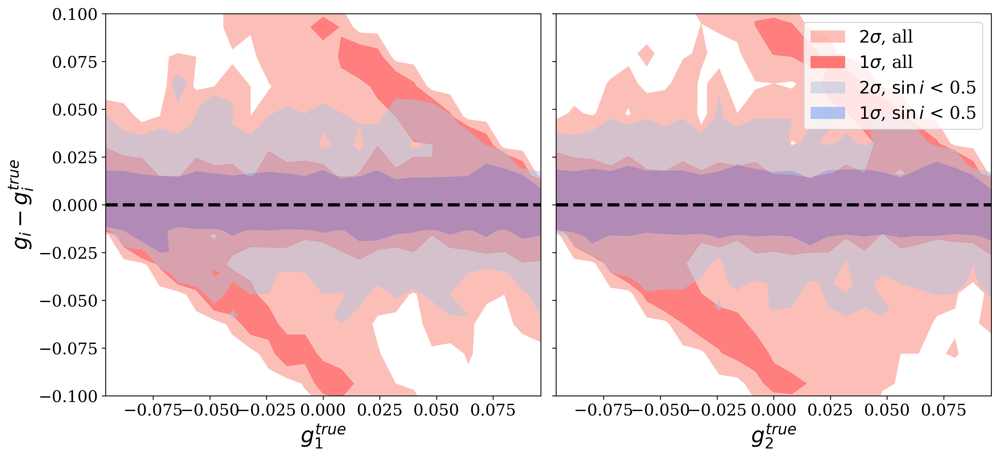

In [80]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig = plt.figure(figsize=(8,6))
fig1,axes = plt.subplots(1,2,sharey=True,figsize=(13,6))

sini_mask = sini[:ngals] < 0.5
nbins = 25

density_contour(g1_true, g1_diff, nbins, nbins, ax=axes[0], colors=['salmon', 'red'])
contour = density_contour(g2_true, g2_diff, nbins, nbins, ax=axes[1], colors=['salmon', 'red'])
density_contour(g1_true[sini_mask], g1_diff[sini_mask], nbins, nbins, ax=axes[0], colors=['lightsteelblue', 'cornflowerblue'])
contour1 = density_contour(g2_true[sini_mask], g2_diff[sini_mask], nbins, nbins, ax=axes[1], colors=['lightsteelblue', 'cornflowerblue'])
axes[0].set_ylim(-0.1,0.1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

handles, _ = contour.legend_elements()
handles1, _ = contour1.legend_elements()
handles += handles1
plt.legend(handles, [r'$2\sigma$, all', r'$1\sigma$, all', 
                     r'$2\sigma$, $\sin i$ < 0.5', r'$1\sigma$, $\sin i$ < 0.5'], fontsize=16)

fig1.subplots_adjust(wspace=0.08,hspace=0.06)

fig1.subplots_adjust(right=0.8)

plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_contour_sini_mle.jpg'))
plt.show()

<Figure size 2400x1800 with 0 Axes>

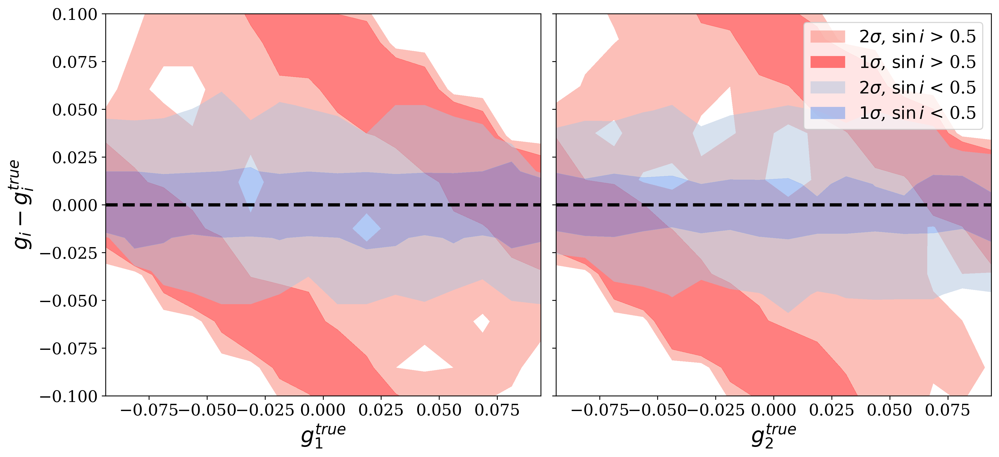

In [85]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig = plt.figure(figsize=(8,6))
fig1,axes = plt.subplots(1,2,sharey=True,figsize=(13,6))

sini_mask = sini[:ngals] < 0.5
nbins = 16

density_contour(g1_true[~sini_mask], g1_diff[~sini_mask], nbins, nbins, ax=axes[0], colors=['salmon', 'red'])
contour = density_contour(g2_true[~sini_mask], g2_diff[~sini_mask], nbins, nbins, ax=axes[1], colors=['salmon', 'red'])
density_contour(g1_true[sini_mask], g1_diff[sini_mask], nbins, nbins, ax=axes[0], colors=['lightsteelblue', 'cornflowerblue'])
contour1 = density_contour(g2_true[sini_mask], g2_diff[sini_mask], nbins, nbins, ax=axes[1], colors=['lightsteelblue', 'cornflowerblue'])
axes[0].set_ylim(-0.1,0.1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

handles, _ = contour.legend_elements()
handles1, _ = contour1.legend_elements()
handles += handles1
plt.legend(handles, [r'$2\sigma$, $\sin i$ > 0.5', r'$1\sigma$, $\sin i$ > 0.5', 
                     r'$2\sigma$, $\sin i$ < 0.5', r'$1\sigma$, $\sin i$ < 0.5'], fontsize=16)

fig1.subplots_adjust(wspace=0.08,hspace=0.06)

fig1.subplots_adjust(right=0.8)

plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_contour_sini_mle_2.jpg'))
plt.show()

<Figure size 2400x1800 with 0 Axes>

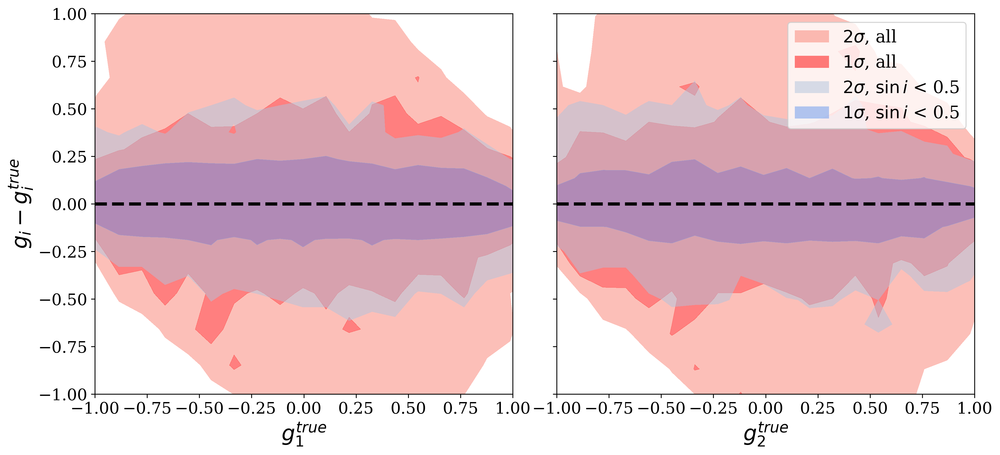

In [71]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig = plt.figure(figsize=(8,6))
fig1,axes = plt.subplots(1,2,sharey=True,figsize=(13,6))

sini_mask = sini[:ngals] < 0.5
nbins = 25

density_contour(gp_true, gp_diff, nbins, nbins, ax=axes[0], colors=['salmon', 'red'])
contour = density_contour(gc_true, gc_diff, nbins, nbins, ax=axes[1], colors=['salmon', 'red'])
density_contour(gp_true[sini_mask], gp_diff[sini_mask], nbins, nbins, ax=axes[0], colors=['lightsteelblue', 'cornflowerblue'])
contour1 = density_contour(gc_true[sini_mask], gc_diff[sini_mask], nbins, nbins, ax=axes[1], colors=['lightsteelblue', 'cornflowerblue'])
axes[0].set_ylim(-1,1)
axes[0].set_xlim(-1,1)
axes[1].set_xlim(-1,1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

handles, _ = contour.legend_elements()
handles1, _ = contour1.legend_elements()
handles += handles1
plt.legend(handles, [r'$2\sigma$, all', r'$1\sigma$, all', 
                     r'$2\sigma$, $\sin i$ < 0.5', r'$1\sigma$, $\sin i$ < 0.5'], fontsize=16)

fig1.subplots_adjust(wspace=0.08,hspace=0.06)

fig1.subplots_adjust(right=0.8)

plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/gx_{stem}_contour_sini_mle.jpg'))
plt.show()

In [37]:
theta_int = np.array(samples['theta_int'])

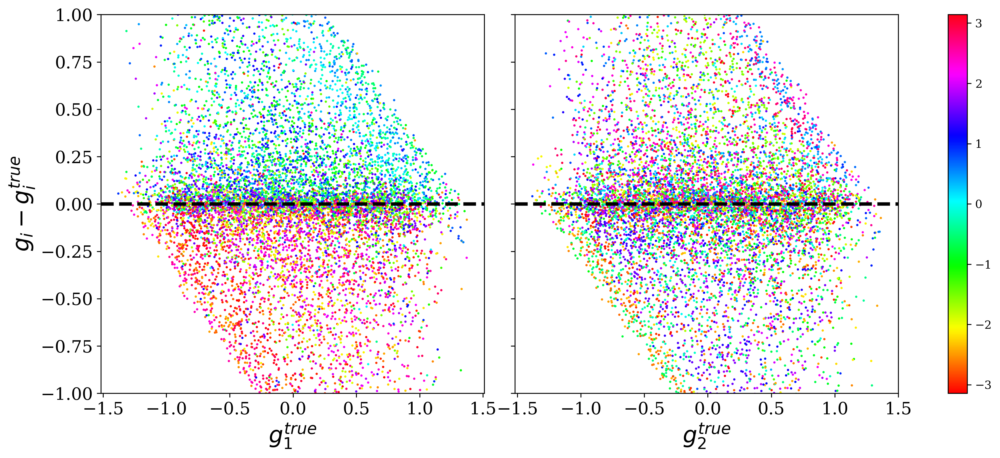

In [67]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig,axes = plt.subplots(1,2,sharey=True,figsize=(18,6))

# snr_mask = SNR > 100

# axes[0].scatter(g1_true, g1_diff, s=10)
# axes[1].scatter(g2_true, g2_diff, s=10)
axes[0].scatter(gp_true, gp_diff, c=theta_int[:ngals], cmap='hsv', s=1)
scat = axes[1].scatter(gc_true, gc_diff, c=theta_int[:ngals], cmap='hsv', s=1)
axes[0].set_ylim(-1,1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

fig.subplots_adjust(wspace=0.08,hspace=0.06)

fig.subplots_adjust(right=0.8)

plt.colorbar(scat, ax=axes)

# plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/gx_{stem}_scatter_theta_mle.jpg'))
plt.show()

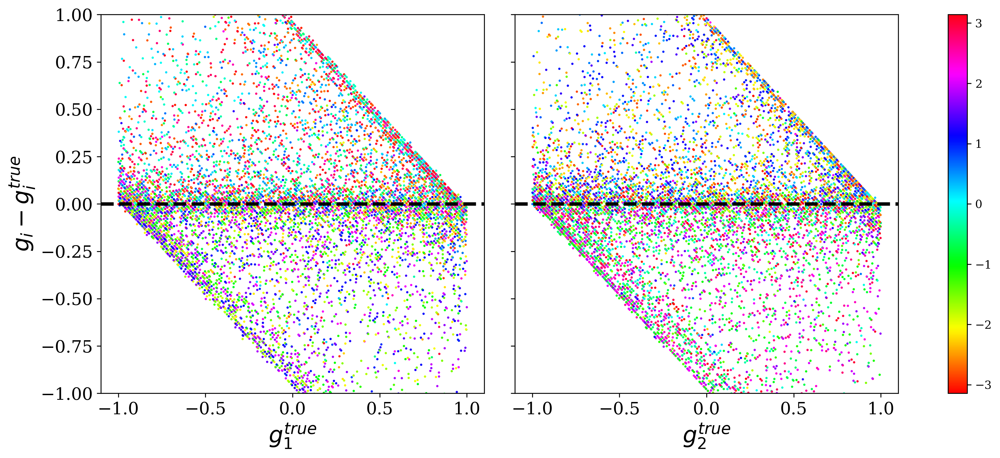

In [38]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig,axes = plt.subplots(1,2,sharey=True,figsize=(18,6))

# snr_mask = SNR > 100

# axes[0].scatter(g1_true, g1_diff, s=10)
# axes[1].scatter(g2_true, g2_diff, s=10)
axes[0].scatter(g1_true, g1_diff, c=theta_int[:ngals], cmap='hsv', s=1)
scat = axes[1].scatter(g2_true, g2_diff, c=theta_int[:ngals], cmap='hsv', s=1)
axes[0].set_ylim(-1,1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

fig.subplots_adjust(wspace=0.08,hspace=0.06)

fig.subplots_adjust(right=0.8)

plt.colorbar(scat, ax=axes)

# plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_scatter_theta_mle.jpg'))
plt.show()

In [39]:
v0 = np.array(samples['v0'])

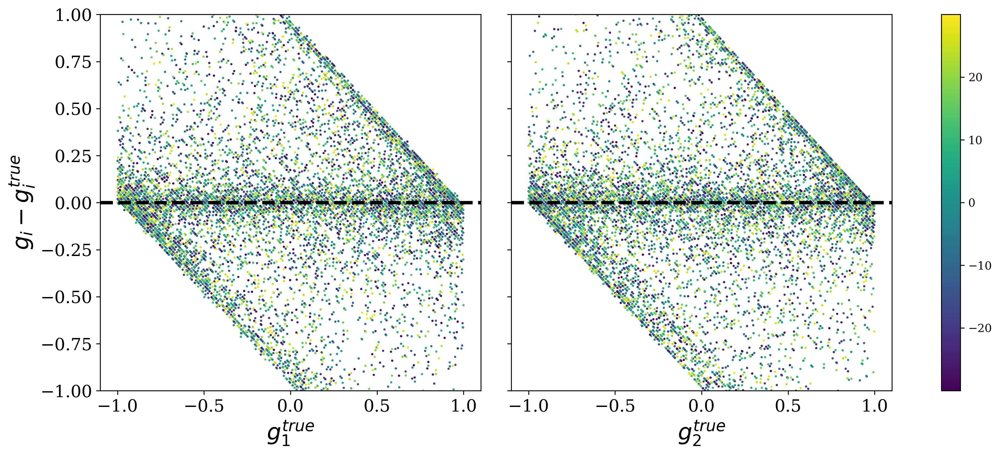

In [40]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig,axes = plt.subplots(1,2,sharey=True,figsize=(18,6))

# snr_mask = SNR > 100

# axes[0].scatter(g1_true, g1_diff, s=10)
# axes[1].scatter(g2_true, g2_diff, s=10)
axes[0].scatter(g1_true, g1_diff, c=v0[:ngals], cmap='viridis', s=1)
scat = axes[1].scatter(g2_true, g2_diff, c=v0[:ngals], cmap='viridis', s=1)
axes[0].set_ylim(-1,1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

fig.subplots_adjust(wspace=0.08,hspace=0.06)

fig.subplots_adjust(right=0.8)

plt.colorbar(scat, ax=axes)

# plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_scatter_v0_mle.jpg'))
plt.show()

In [46]:
vcirc = np.array(samples['vcirc'])

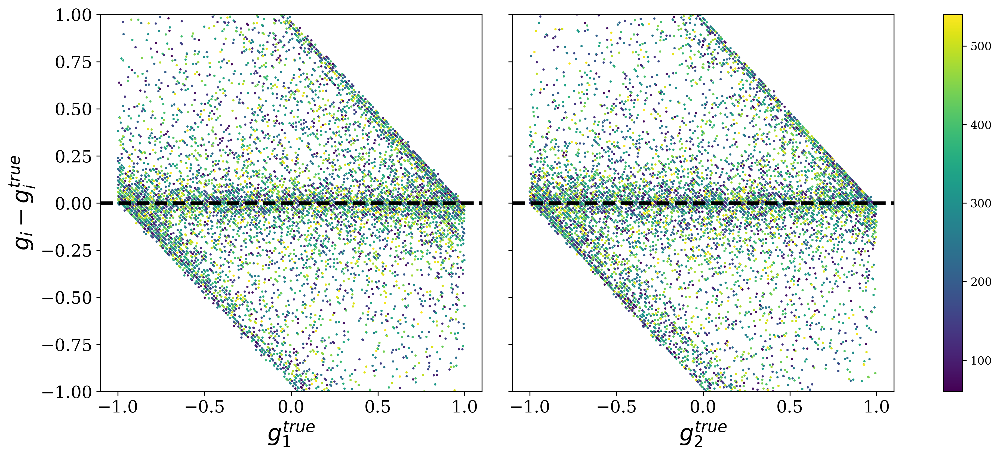

In [47]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig,axes = plt.subplots(1,2,sharey=True,figsize=(18,6))

# snr_mask = SNR > 100

# axes[0].scatter(g1_true, g1_diff, s=10)
# axes[1].scatter(g2_true, g2_diff, s=10)
axes[0].scatter(g1_true, g1_diff, c=vcirc[:ngals], cmap='viridis', s=1)
scat = axes[1].scatter(g2_true, g2_diff, c=vcirc[:ngals], cmap='viridis', s=1)
axes[0].set_ylim(-1,1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

fig.subplots_adjust(wspace=0.08,hspace=0.06)

fig.subplots_adjust(right=0.8)

plt.colorbar(scat, ax=axes)

# plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_scatter_vcirc_mle.jpg'))
plt.show()

In [48]:
rscale = np.array(samples['rscale'])

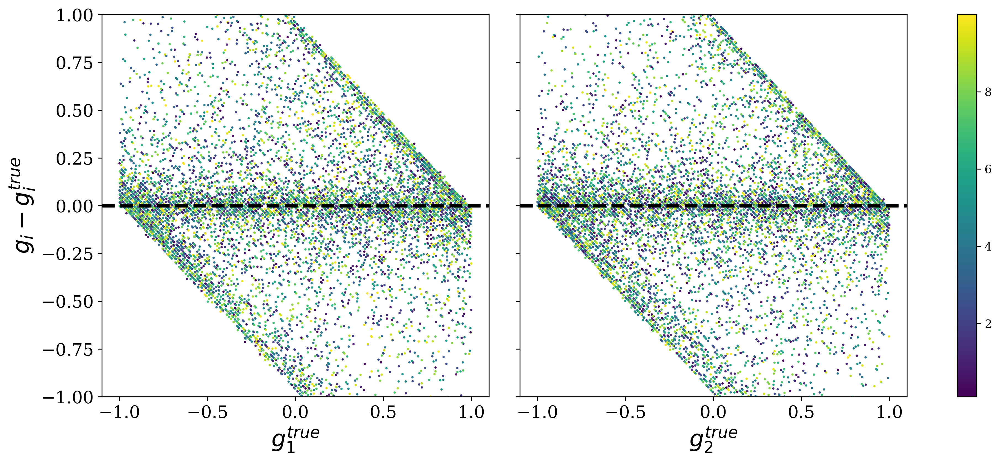

In [51]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig,axes = plt.subplots(1,2,sharey=True,figsize=(18,6))

# snr_mask = SNR > 100

# axes[0].scatter(g1_true, g1_diff, s=10)
# axes[1].scatter(g2_true, g2_diff, s=10)
axes[0].scatter(g1_true, g1_diff, c=rscale[:ngals], cmap='viridis', s=1)
scat = axes[1].scatter(g2_true, g2_diff, c=rscale[:ngals], cmap='viridis', s=1)
axes[0].set_ylim(-1,1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

fig.subplots_adjust(wspace=0.08,hspace=0.06)

fig.subplots_adjust(right=0.8)

plt.colorbar(scat, ax=axes)

# plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_scatter_rscale_mle.jpg'))
plt.show()

In [52]:
hlr = np.array(samples['hlr'])

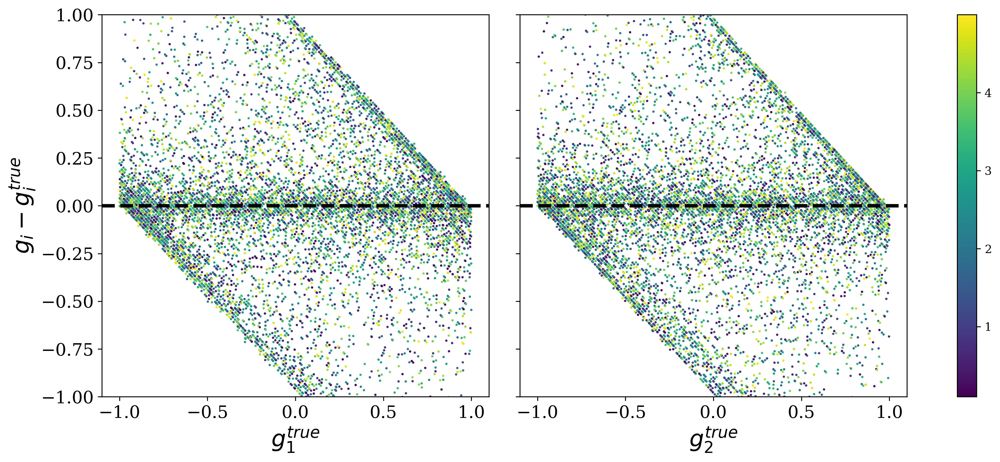

In [53]:
plt.rcParams.update({"text.usetex": False, "font.family": "serif", "figure.dpi": 300})
fig,axes = plt.subplots(1,2,sharey=True,figsize=(18,6))

# snr_mask = SNR > 100

# axes[0].scatter(g1_true, g1_diff, s=10)
# axes[1].scatter(g2_true, g2_diff, s=10)
axes[0].scatter(g1_true, g1_diff, c=hlr[:ngals], cmap='viridis', s=1)
scat = axes[1].scatter(g2_true, g2_diff, c=hlr[:ngals], cmap='viridis', s=1)
axes[0].set_ylim(-1,1)

for i in range(2):
    axes[i].axhline(0,color='k',linestyle='--',linewidth=3)
    
axes[0].set_xlabel(r'$g_1^{true}$',fontsize=20)
axes[1].set_xlabel(r'$g_2^{true}$',fontsize=20)
axes[0].set_ylabel(r'$g_i-g_i^{true}$',fontsize=20)

axes[0].tick_params(axis='both',which='major',labelsize=15)
axes[1].tick_params(axis='x',which='major',labelsize=15)

fig.subplots_adjust(wspace=0.08,hspace=0.06)

fig.subplots_adjust(right=0.8)

plt.colorbar(scat, ax=axes)

# plt.tight_layout()
plt.savefig(join(fig_dir, f'{stem}/g_{stem}_scatter_hlr_mle.jpg'))
plt.show()